<a href="https://colab.research.google.com/github/YanCheng-go/carbon-plus/blob/master/Carbon-plus.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Exploration of relationships between carbon sink and carbon emission 
1. Data preprocessing
2. Simple visualization of data distribution
3. Visualize spatial and temporal distribution of carbon sink and carbon emission 
4. Visualize the relationship between carbon sink and emission ++++

In [1]:
!pip install pinyin

In [2]:
from google.colab import drive
drive.mount('/content/drive/', force_remount=True)

Mounted at /content/drive/


In [3]:
%cd drive/My Drive/WRI/carbon-plus

/content/drive/My Drive/WRI/carbon-plus


In [4]:
!git clone https://github.com/YanCheng-go/carbon-plus.git

fatal: destination path 'carbon-plus' already exists and is not an empty directory.


In [5]:
import IPython
def configure_plotly_browser_state():
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-1.5.1.min.js?noext',
            },
          });
        </script>
        '''))

## Data pre-processing

In [6]:
import pandas as pd
import numpy as np

# EMISSION_PATH = r'D:\Users\yan.cheng\PycharmProjects\pythonProject\carbon\data\china_emission.xlsx'
# SINK_PATH = r'D:\Users\yan.cheng\PycharmProjects\pythonProject\carbon\data\省级碳汇和生态元数据.xlsx'

EMISSION_PATH = '/content/drive/My Drive/WRI/carbon-plus/carbon-plus/data/china_emission.xlsx'
SINK_PATH = '/content/drive/My Drive/WRI/carbon-plus/carbon-plus/data/省级碳汇和生态元数据.xlsx'

In [7]:
# Query values 
df_emission = pd.read_excel(EMISSION_PATH, 'master')
df_emission = df_emission[df_emission['type']=='总排放（万吨CO2）'].iloc[:,1:]
df_emission = df_emission.drop('type', axis=1)

# Add missing provinces 
df_emission_copy = df_emission
miss_ROIs = ['西藏','香港','澳门','台湾']
df_emission_copy[miss_ROIs] = np.nan
emission_mean_copy = df_emission_copy.iloc[:, 1:].mean(axis=0)

In [8]:
df_emission

,year,北京市,天津市,河北省,山西省,内蒙古自治区,辽宁省,吉林省,黑龙江省,上海市,江苏省,浙江省,安徽省,福建省,江西省,山东省,河南省,湖北省,湖南省,广东省,广西壮族自治区,海南省,重庆市,四川省,贵州省,云南省,陕西省,甘肃省,青海省,宁夏回族自治区,新疆维吾尔自治区,西藏,香港,澳门,台湾
0,1995,9232.173750,7422.710350,22646.580000,15815.084500,8845.967500,25562.875450,11237.526200,15788.730800,12979.476600,23190.703200,12719.737960,10713.994300,5117.524700,6315.677800,22365.401040,16153.717500,14367.139200,13183.063580,21859.124000,5960.599100,842.564800,0.000000,17212.930580,7201.955400,5358.060600,7770.876080,6334.589520,1401.575200,1850.946600,7349.828500,NaN,NaN,NaN,NaN
1,1996,10032.304300,7088.990200,23298.031900,16342.312700,9632.591800,25860.112600,12037.373700,16000.224200,13924.867000,23686.830300,13996.295660,11534.361200,5778.558300,6274.754180,22744.401720,16542.888300,12717.690100,13466.550880,23539.919400,6032.340100,923.018600,0.000000,17203.357300,7691.325200,5785.004000,4303.844000,5928.057500,1343.371160,1944.771300,8478.651500,NaN,NaN,NaN,NaN
2,1997,8137.488100,5707.964600,23131.886100,15436.109100,10197.031300,20382.090150,10618.724300,13899.143000,10837.163800,19687.171840,12009.666520,11021.499500,4341.602700,5345.221860,18630.922500,15573.424840,13960.001700,10190.878740,16634.129800,5228.546400,591.083000,5839.512380,12431.819800,6752.451300,5768.347400,6772.731300,5163.955920,1249.611280,1765.066300,6650.669300,NaN,NaN,NaN,NaN
3,1998,8412.407580,5722.208600,24381.187770,15324.207520,9691.408610,20220.039640,9127.917910,14046.833510,11059.855590,19879.930160,11722.332850,11427.439750,4727.910470,5237.660830,20756.864900,15486.014540,13789.512650,10363.654920,18510.774390,5453.393380,1375.612570,6373.696450,12403.683000,10601.147200,6678.091280,6739.136540,5176.091720,1213.231900,1845.258950,6832.313760,NaN,NaN,NaN,NaN
4,1999,8819.740900,5917.965880,22881.649700,15107.016090,10163.573990,20147.525920,9254.903450,12955.234420,11808.229800,19165.321970,12105.781460,11671.791130,5895.354900,4917.767430,20727.795500,15492.827920,14126.525190,8317.164270,18479.133180,5517.400380,776.709200,6988.379880,10826.044300,8334.935100,5342.983560,5911.432330,5342.938540,1440.125800,1844.222320,6676.881780,NaN,NaN,NaN,NaN
5,2000,9418.871610,6654.929530,25705.017440,15406.867680,11984.126387,25108.708505,8225.896231,13868.775486,13467.563578,22965.294759,8977.458421,12613.463141,5853.208140,5663.288129,18623.905587,18876.168786,14801.072530,8228.942510,20457.331678,6184.347267,875.174074,7806.400509,10608.921390,9068.932910,5569.800050,6123.111890,5865.335496,1364.859090,0.000000,7205.439414,NaN,NaN,NaN,NaN
6,2001,10734.247898,6756.515270,27349.159430,19067.916030,13069.100813,22174.198874,9786.637531,13696.562663,14105.641624,21973.505033,15087.590218,13563.998635,5760.294630,6138.511074,23123.377254,19014.041921,14048.663150,8162.882080,21364.938411,6004.279082,904.408553,7203.090735,10821.237190,9047.107500,6505.517170,6243.398220,5938.819434,1638.057120,0.000000,7481.576710,NaN,NaN,NaN,NaN
7,2002,10883.469826,7403.087850,30652.068790,22805.741360,14524.728569,24738.779201,10098.129340,12797.425111,14877.272727,23829.288933,16797.661893,14277.844160,7032.748160,6451.860292,26142.406913,19221.402828,16935.452480,6932.838690,23257.804756,6048.421427,0.000000,7695.902130,12448.952610,9459.814510,7548.459500,7704.500460,6396.366816,1706.581950,0.000000,7078.052219,NaN,NaN,NaN,NaN
8,2003,11591.269068,7577.162900,35287.297880,25319.971790,13558.124645,26756.575140,11205.805414,13114.482954,15924.876634,26963.434116,18808.778057,16053.104810,9314.541010,7857.375298,34019.144321,21425.928214,17519.244330,10874.024170,26684.233385,7489.093472,1618.963635,6718.056948,16084.613350,12046.123750,12338.701941,8153.363750,7357.083507,2042.689070,5812.129440,8198.999400,NaN,NaN,NaN,NaN
9,2004,12479.526260,8697.016840,40272.887762,26691.521360,22149.737824,30038.338090,12244.470629,14174.928922,17098.633912,34861.336002,23037.918388,16458.005480,10494.994280,9164.703055,41716.396472,25252.564228,19362.988730,12243.784389,32229.493398,10184.025567,1546.331667,7507.0

In [9]:
df_emission_copy

,year,北京市,天津市,河北省,山西省,内蒙古自治区,辽宁省,吉林省,黑龙江省,上海市,江苏省,浙江省,安徽省,福建省,江西省,山东省,河南省,湖北省,湖南省,广东省,广西壮族自治区,海南省,重庆市,四川省,贵州省,云南省,陕西省,甘肃省,青海省,宁夏回族自治区,新疆维吾尔自治区,西藏,香港,澳门,台湾
0,1995,9232.173750,7422.710350,22646.580000,15815.084500,8845.967500,25562.875450,11237.526200,15788.730800,12979.476600,23190.703200,12719.737960,10713.994300,5117.524700,6315.677800,22365.401040,16153.717500,14367.139200,13183.063580,21859.124000,5960.599100,842.564800,0.000000,17212.930580,7201.955400,5358.060600,7770.876080,6334.589520,1401.575200,1850.946600,7349.828500,NaN,NaN,NaN,NaN
1,1996,10032.304300,7088.990200,23298.031900,16342.312700,9632.591800,25860.112600,12037.373700,16000.224200,13924.867000,23686.830300,13996.295660,11534.361200,5778.558300,6274.754180,22744.401720,16542.888300,12717.690100,13466.550880,23539.919400,6032.340100,923.018600,0.000000,17203.357300,7691.325200,5785.004000,4303.844000,5928.057500,1343.371160,1944.771300,8478.651500,NaN,NaN,NaN,NaN
2,1997,8137.488100,5707.964600,23131.886100,15436.109100,10197.031300,20382.090150,10618.724300,13899.143000,10837.163800,19687.171840,12009.666520,11021.499500,4341.602700,5345.221860,18630.922500,15573.424840,13960.001700,10190.878740,16634.129800,5228.546400,591.083000,5839.512380,12431.819800,6752.451300,5768.347400,6772.731300,5163.955920,1249.611280,1765.066300,6650.669300,NaN,NaN,NaN,NaN
3,1998,8412.407580,5722.208600,24381.187770,15324.207520,9691.408610,20220.039640,9127.917910,14046.833510,11059.855590,19879.930160,11722.332850,11427.439750,4727.910470,5237.660830,20756.864900,15486.014540,13789.512650,10363.654920,18510.774390,5453.393380,1375.612570,6373.696450,12403.683000,10601.147200,6678.091280,6739.136540,5176.091720,1213.231900,1845.258950,6832.313760,NaN,NaN,NaN,NaN
4,1999,8819.740900,5917.965880,22881.649700,15107.016090,10163.573990,20147.525920,9254.903450,12955.234420,11808.229800,19165.321970,12105.781460,11671.791130,5895.354900,4917.767430,20727.795500,15492.827920,14126.525190,8317.164270,18479.133180,5517.400380,776.709200,6988.379880,10826.044300,8334.935100,5342.983560,5911.432330,5342.938540,1440.125800,1844.222320,6676.881780,NaN,NaN,NaN,NaN
5,2000,9418.871610,6654.929530,25705.017440,15406.867680,11984.126387,25108.708505,8225.896231,13868.775486,13467.563578,22965.294759,8977.458421,12613.463141,5853.208140,5663.288129,18623.905587,18876.168786,14801.072530,8228.942510,20457.331678,6184.347267,875.174074,7806.400509,10608.921390,9068.932910,5569.800050,6123.111890,5865.335496,1364.859090,0.000000,7205.439414,NaN,NaN,NaN,NaN
6,2001,10734.247898,6756.515270,27349.159430,19067.916030,13069.100813,22174.198874,9786.637531,13696.562663,14105.641624,21973.505033,15087.590218,13563.998635,5760.294630,6138.511074,23123.377254,19014.041921,14048.663150,8162.882080,21364.938411,6004.279082,904.408553,7203.090735,10821.237190,9047.107500,6505.517170,6243.398220,5938.819434,1638.057120,0.000000,7481.576710,NaN,NaN,NaN,NaN
7,2002,10883.469826,7403.087850,30652.068790,22805.741360,14524.728569,24738.779201,10098.129340,12797.425111,14877.272727,23829.288933,16797.661893,14277.844160,7032.748160,6451.860292,26142.406913,19221.402828,16935.452480,6932.838690,23257.804756,6048.421427,0.000000,7695.902130,12448.952610,9459.814510,7548.459500,7704.500460,6396.366816,1706.581950,0.000000,7078.052219,NaN,NaN,NaN,NaN
8,2003,11591.269068,7577.162900,35287.297880,25319.971790,13558.124645,26756.575140,11205.805414,13114.482954,15924.876634,26963.434116,18808.778057,16053.104810,9314.541010,7857.375298,34019.144321,21425.928214,17519.244330,10874.024170,26684.233385,7489.093472,1618.963635,6718.056948,16084.613350,12046.123750,12338.701941,8153.363750,7357.083507,2042.689070,5812.129440,8198.999400,NaN,NaN,NaN,NaN
9,2004,12479.526260,8697.016840,40272.887762,26691.521360,22149.737824,30038.338090,12244.470629,14174.928922,17098.633912,34861.336002,23037.918388,16458.005480,10494.994280,9164.703055,41716.396472,25252.564228,19362.988730,12243.784389,32229.493398,10184.025567,1546.331667,7507.0

In [10]:
emission_mean_copy

北京市         12830.657511
天津市         12503.814607
河北省         56865.884387
山西省         32168.802258
内蒙古自治区      35369.054712
辽宁省         39726.670520
吉林省         17046.776034
黑龙江省        20686.802258
上海市         19571.587775
江苏省         47833.566307
浙江省         28347.685656
安徽省         21912.065574
福建省         14619.809731
江西省         12506.385188
山东省         58846.353164
河南省         36848.103496
湖北省         24767.587179
湖南省         21705.324942
广东省         41466.527083
广西壮族自治区     13191.640646
海南省          2128.479160
重庆市         11551.388365
四川省         22216.104643
贵州省         15663.406478
云南省         13009.035495
陕西省         14993.310759
甘肃省         10375.989682
青海省          3027.506597
宁夏回族自治区      7300.039085
新疆维吾尔自治区    17293.623764
西藏                   NaN
香港                   NaN
澳门                   NaN
台湾                   NaN
dtype: float64

In [11]:
# Query values 
df_sink = pd.read_excel(SINK_PATH,'碳汇')
df_sink = df_sink.T.reset_index()
df_sink.columns = ['year'] + list(df_sink.iloc[0, 1:])
df_sink = df_sink[1:]

# Add missing provinces 
df_sink_copy = df_sink
miss_ROIs = ['西藏','香港','澳门','台湾']
df_sink_copy[miss_ROIs] = np.nan
sink_mean_copy = df_sink_copy.iloc[:, 1:].mean(axis=0)

## Data overview

### Time series 
1. TO-DO: interaction

No handles with labels found to put in legend.


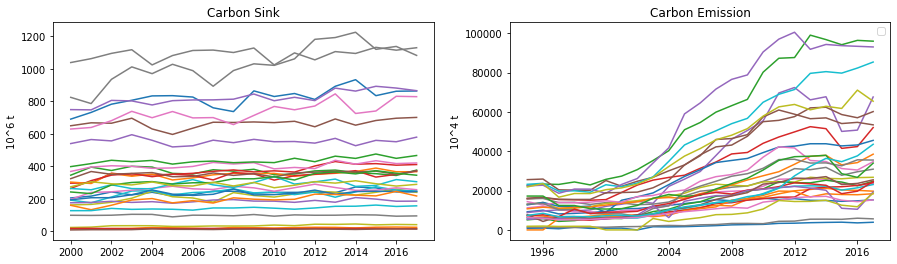

In [12]:
import matplotlib.pyplot as plt
fig = plt.figure(figsize=(15,4))
ax1 = fig.add_subplot(121)
ax2 = fig.add_subplot(122)
# fig, (ax1, ax2) = plt.subplots(1, 2)

for i in range(df_sink.shape[1]-1):
    ax1.plot(pd.to_datetime(df_sink['year'], format='%Y'), df_sink.iloc[:, i+1])
    
ax1.set_ylabel('10^6 t')
ax1.set_title('Carbon Sink')
# ax1.legend()

for i in range(df_emission.shape[1]-1):
    ax2.plot(pd.to_datetime(df_emission['year'], format='%Y'), df_emission.iloc[:, i+1])
    
ax2.set_ylabel('10^4 t')
ax2.set_title('Carbon Emission')
ax2.legend()

plt.show()

### Time Series Per Province

TO-DO: Standardize the range of y-axis

In [13]:
import ipywidgets as widgets
from __future__ import print_function
from ipywidgets import interact, interactive, fixed, interact_manual
import pinyin
import matplotlib.pyplot as plt

NAMES = df_sink.columns[1:]

def f(province):
    fig = plt.figure(figsize=(15,4))
    ax1 = fig.add_subplot(121)
    ax2 = fig.add_subplot(122)
    
    ax1.plot(pd.to_datetime(df_sink['year'], format='%Y'), df_sink[province])
    ax1.set_xlabel('Year')
    ax1.set_ylabel('10^6 t')
    ax1.set_title('Carbon Sink in {}'.format(pinyin.get(province, format="strip", delimiter="")))
    
    ax2.plot(pd.to_datetime(df_emission['year'], format='%Y'), df_emission[province])
    ax2.set_xlabel('Year')
    ax2.set_ylabel('10^4 t')
    ax2.set_title('Carbon Emission in {}'.format(pinyin.get(province, format="strip", delimiter="")))

a = interact(f, province=NAMES)

interactive(children=(Dropdown(description='province', options=('安徽省', '北京市', '福建省', '甘肃省', '广东省', '广西壮族自治区', …

#### Interactively plots based on plotly

1.TO-DO:

    a. 中文支持！！！
    b. multiple selection
    c. Standardize the range of y-axis

In [14]:
import ipywidgets as widgets
from __future__ import print_function
from ipywidgets import interact, interactive, fixed, interact_manual
import pinyin
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from plotly.offline import init_notebook_mode, iplot
from plotly.graph_objs import Contours, Histogram2dContour, Marker, Scatter

configure_plotly_browser_state()

init_notebook_mode(connected=False)

def f(province):
    # Create figure with secondary y-axis
    fig = make_subplots(specs=[[{"secondary_y": True}]])

    fig.add_trace(go.Scatter(x=df_sink['year'], y=df_sink[province], 
                    mode='lines+markers', name='Carbon Sink'))
    fig.add_trace(go.Scatter(x=df_emission['year'], y=df_emission[province], 
                    mode='lines+markers', name='Carbon Emission'), secondary_y=True)
    
    # Add figure title
    fig.update_layout(
        title_text="Carbon Sink and Emission in <b>{}</b>".format(pinyin.get(province, format="strip", delimiter=""))
    )

    # Set x-axis title
    fig.update_xaxes(title_text="Year")

    # Set y-axes titles
    fig.update_yaxes(title_text="<b>Carbon Sink</b> 10^6 t", secondary_y=False)
    fig.update_yaxes(title_text="<b>Carbon Emission</b> 10^4 t", secondary_y=True)

    fig.show()

NAMES = df_sink.columns[1:]
a = interact(f, province=NAMES)

interactive(children=(Dropdown(description='province', options=('安徽省', '北京市', '福建省', '甘肃省', '广东省', '广西壮族自治区', …

### Spatial distribution of carbon sink and emission

reference: https://chart-studio.plotly.com/~empet/15238/tips-to-extract-data-from-a-geojson-di/#/

In [15]:
import ipywidgets as widgets
from __future__ import print_function
from ipywidgets import interact, interactive, fixed, interact_manual
import pinyin
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import numpy as np
import pandas as pd
import json
import urllib.request
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode,  iplot
init_notebook_mode(connected=True)

MAPBOX_TOKEN = open('/content/drive/MyDrive/WRI/carbon-plus/carbon-plus/credentials/mapbox.txt').read().rstrip()

In [16]:
# Access China boundary data - geojson format
CHINA_URL = 'https://raw.githubusercontent.com/chemzqm/geomap/master/china-province.geojson'
def read_geojson(url):
    with urllib.request.urlopen(url) as url:
        jdata = json.loads(url.read().decode())
    return jdata 
jdata = read_geojson(CHINA_URL)
jdata

{'features': [{'geometry': {'coordinates': [[[123.0946121346689,
       46.24909196774673],
      [123.04637971728197, 46.3454714602227],
      [122.99432766253867, 46.42249659722913],
      [122.96786721954466, 46.48405277238638],
      [122.94868808883851, 46.508789913524204],
      [122.94523045892336, 46.5156824663206],
      [122.96830719133945, 46.53660096091846],
      [122.99202244499487, 46.56075607104473],
      [123.01067556787906, 46.608377924165076],
      [123.021319984884, 46.6139905957785],
      [123.0617731611717, 46.60044675142658],
      [123.10123733446622, 46.60671796989151],
      [123.1535699689764, 46.60521546527491],
      [123.1980566656105, 46.58796886573442],
      [123.23220601159207, 46.591401334409014],
      [123.25792168917181, 46.62520772229288],
      [123.30780938556033, 46.660060489192404],
      [123.34860859757907, 46.67273430541976],
      [123.41636181436319, 46.67628409354287],
      [123.48412293852381, 46.67980662593241],
      [123.51149465

In [17]:
# Check the naming system
n_ROI = len(jdata['features']) # number of ROIs
locations = [k for k in range(n_ROI)]
text = [feat['properties']['NAME']  for feat in jdata['features'] if feat['id'] in locations] #province names
print(text)

['黑龙江', '新疆', '山西', '宁夏', '西藏', '山东', '河南', '江苏', '安徽', '湖北', '浙江', '江西', '湖南', '云南', '贵州', '福建', '广西', '广东', '海南', '吉林', '辽宁', '天津', '青海', '甘肃', '陕西', '内蒙古', '重庆', '河北', '上海', '北京', '台湾', '香港', '澳门', '四川']


In [18]:
from plotly.offline import init_notebook_mode, iplot
from plotly.graph_objs import Contours, Histogram2dContour, Marker, Scatter

configure_plotly_browser_state()

init_notebook_mode(connected=False)

# Harmonize carbon sink and emission file and geojson file
def harm(df):
    z = df.reset_index()
    z.columns = ['name', 'value']
    z['location_idx'] = [np.nan]*len(z)

    for loc_idx, loc_name in enumerate(text):
        for df_idx, df_name in enumerate(z['name']):
            if (loc_name in df_name) | (df_name in loc_name):
                z.loc[df_idx, 'location_idx'] = loc_idx
    
    return z.set_index('location_idx').sort_index()

# Plot map
fig= go.Figure(go.Choroplethmapbox(z=harm(sink_mean_copy)['value'],
                            locations=locations,
                            colorscale='greens',
                            colorbar=dict(thickness=20, ticklen=3),
                            geojson=jdata,
                            text=text,
                            hoverinfo='all',
                            marker_line_width=1, marker_opacity=0.75))
                            
                            
fig.update_layout(title_text= 'Mean Carbon Sink from 2000 to 2017',
                  title_x=0.5, width = 700,# height=700,
                  mapbox = dict(center= dict(lat=36.913818,  lon=106.363625),
                                 accesstoken= MAPBOX_TOKEN,
                                 style='basic',
                                 zoom=2.35,
                               ));

fig.data[0].hovertemplate =  '<b>Province</b>: <b>%{text}</b>'+\
                              '<br> <b>Val </b>: %{z}<br>'
iplot(fig)

# Emission
fig= go.Figure(go.Choroplethmapbox(z=harm(emission_mean_copy)['value'],
                            locations=locations,
                            colorscale='reds',
                            colorbar=dict(thickness=20, ticklen=3),
                            geojson=jdata,
                            text=text,
                            hoverinfo='all',
                            marker_line_width=1, marker_opacity=0.75))
                            
                            
fig.update_layout(title_text= 'Mean Carbon Emission from 1995 to 2017',
                  title_x=0.5, width = 700,# height=700,
                  mapbox = dict(center= dict(lat=36.913818,  lon=106.363625),
                                 accesstoken= MAPBOX_TOKEN,
                                 style='basic',
                                 zoom=2.35,
                               ));

fig.data[0].hovertemplate =  '<b>Province</b>: <b>%{text}</b>'+\
                              '<br> <b>Val </b>: %{z}<br>'
iplot(fig)

In [19]:
from plotly.offline import init_notebook_mode, iplot
from plotly.graph_objs import Contours, Histogram2dContour, Marker, Scatter

configure_plotly_browser_state()

init_notebook_mode(connected=False)

def harm_annual(df, year):
    z = df.loc[df['year']==int(year), df.columns[1:]].T.reset_index()
    z.columns = ['name', 'value']
    z['location_idx'] = [np.nan]*len(z)

    for loc_idx, loc_name in enumerate(text):
        for df_idx, df_name in enumerate(z['name']):
            if (loc_name in df_name) | (df_name in loc_name):
                z.loc[df_idx, 'location_idx'] = loc_idx

    return z.set_index('location_idx').sort_index()

def map_carbon(year):
    fig= go.Figure(go.Choroplethmapbox(z=harm_annual(df_sink_copy, year)['value'],
                                locations=locations,
                                colorscale='greens',
                                colorbar=dict(thickness=20, ticklen=3),
                                geojson=jdata,
                                text=text,
                                hoverinfo='all',
                                marker_line_width=1, marker_opacity=0.75))


    fig.update_layout(title_text= 'Carbon Emission (10^4 t) in {}'.format(year),
                      title_x=0.5, width = 700,# height=700,
                      mapbox = dict(center= dict(lat=36.913818,  lon=106.363625),
                                     accesstoken= MAPBOX_TOKEN,
                                     style='basic',
                                     zoom=2.35,
                                   ));

    fig.data[0].hovertemplate =  '<b>Province</b>: <b>%{text}</b>'+\
                                  '<br> <b>Val </b>: %{z}<br>'
    iplot(fig)

    # Emission
    fig= go.Figure(go.Choroplethmapbox(z=harm_annual(df_emission_copy, year)['value'],
                                locations=locations,
                                colorscale='reds',
                                colorbar=dict(thickness=20, ticklen=3),
                                geojson=jdata,
                                text=text,
                                hoverinfo='all',
                                marker_line_width=1, marker_opacity=0.75))


    fig.update_layout(title_text= 'Carbon Emission (10^6 t) in {}'.format(year),
                      title_x=0.5, width = 700,# height=700,
                      mapbox = dict(center= dict(lat=36.913818,  lon=106.363625),
                                     accesstoken= MAPBOX_TOKEN,
                                     style='basic',
                                     zoom=2.35,
                                   ));

    fig.data[0].hovertemplate =  '<b>Province</b>: <b>%{text}</b>'+\
                                  '<br> <b>Val </b>: %{z}<br>'
    iplot(fig)

year = widgets.IntSlider(
    value=2017,
    min=2000,
    max=2017,
    step=1,
    description='Year',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)

a = interact(map_carbon, year=year)


interactive(children=(IntSlider(value=2017, continuous_update=False, description='Year', max=2017, min=2000), …

### Carbon + 
reference: https://pubs.aeaweb.org/doi/pdf/10.1257/jep.28.1.209

https://www.wri.org/blog/2020/07/decoupling-emissions-gdp-us

Read WRI blogs or other reference
- Which datasets??
- Which types of charts???

#### Import and orgnize dataset

In [20]:
PP_PATH = '/content/drive/MyDrive/WRI/carbon-plus/carbon-plus/data/china_stats_gov_provincial_data_master.xlsx'

In [21]:
# Read data
import pandas as pd
df_PP = pd.read_excel(PP_PATH)
df_PP.head(5)

,uid,lv1,lv2,lv3,lv4,year,北京市,天津市,河北省,山西省,内蒙古自治区,辽宁省,吉林省,黑龙江省,上海市,江苏省,浙江省,安徽省,福建省,江西省,山东省,河南省,湖北省,湖南省,广东省,广西壮族自治区,海南省,重庆市,四川省,贵州省,云南省,西藏自治区,陕西省,甘肃省,青海省,宁夏回族自治区,新疆维吾尔自治区
0,0,人口,人口出生率、死亡率和自然增长率,人口出生率(‰),人口出生率(‰),2019,8.12,6.73,10.83,9.12,8.23,6.45,6.05,5.73,7.00,9.12,10.51,12.03,12.9,12.59,11.77,11.02,11.35,10.39,12.54,13.31,12.87,10.48,10.70,13.65,12.63,14.60,10.55,10.60,13.66,13.72,8.14
1,1,人口,人口出生率、死亡率和自然增长率,人口出生率(‰),人口出生率(‰),2018,8.24,6.67,11.26,9.63,8.35,6.39,6.62,5.98,7.20,9.32,11.02,12.41,13.2,13.43,13.26,11.72,11.54,12.19,12.79,14.12,14.48,11.02,11.05,13.90,13.19,15.22,10.67,11.07,14.31,13.32,10.69
2,2,人口,人口出生率、死亡率和自然增长率,人口出生率(‰),人口出生率(‰),2017,9.06,7.65,13.20,11.06,9.47,6.49,6.76,6.22,8.10,9.71,11.92,14.07,15.0,13.79,17.54,12.95,12.60,13.27,13.68,15.14,14.73,11.18,11.26,13.98,13.53,16.00,11.11,12.54,14.42,13.44,15.88
3,3,人口,人口出生率、死亡率和自然增长率,人口出生率(‰),人口出生率(‰),2016,9.32,7.37,12.42,10.29,9.03,6.60,5.55,6.12,9.00,9.76,11.22,13.02,14.5,13.45,17.89,13.26,12.04,13.57,11.85,13.82,14.57,11.77,10.48,13.43,13.16,15.79,10.64,12.18,14.70,13.69,15.34
4,4,人口,人口出生率、死亡率和自然增长率,人口出生率(‰),人口出生率(‰),2015,7.96,5.84,11.35,9.98,7.72,6.17,5.87,6.00,7.52,9.05,10.52,12.92,13.9,13.20,12.55,12.70,10.74,13.58,11.12,14.05,14.57,11.05,10.30,13.00,12.88,15.75,10.10,12.36,14.72,12.62,15.59


In [22]:
fids = df_PP.columns
fids

Index(['uid', 'lv1', 'lv2', 'lv3', 'lv4', 'year', '北京市', '天津市', '河北省', '山西省',
       '内蒙古自治区', '辽宁省', '吉林省', '黑龙江省', '上海市', '江苏省', '浙江省', '安徽省', '福建省',
       '江西省', '山东省', '河南省', '湖北省', '湖南省', '广东省', '广西壮族自治区', '海南省', '重庆市',
       '四川省', '贵州省', '云南省', '西藏自治区', '陕西省', '甘肃省', '青海省', '宁夏回族自治区',
       '新疆维吾尔自治区'],
      dtype='object')

In [23]:
for i in range(1, 5):
    print('lv{}: \n{}\n'.format(i,set(df_PP[fids[i]])))

lv1: 
{'财政', '农业', '人民生活', '人口', '综合', '国民经济核算', '能源', '城市概况', '资源和环境', '建筑业', '对外经济贸易', '运输和邮电', '固定资产投资和房地产', '价格指数', '就业人员和工资', '工业'}

lv2: 
{'受灾和成灾面积', '自然灾害', '个体就业人员', '建筑业企业技术装备情况', '城市供水', '按登记注册类型分建筑业企业利润总额', '能源工业固定资产投资(不含农户)', '国有控股工业企业主要经济指标', '私营工业企业主要经济指标', '全社会房屋施工、竣工面积和价值', '城镇居民家庭平均每百户耐用消费品拥有量（老口径）', '按登记注册类型分城镇单位就业人员平均工资', '固定资产投资(不含农户)按行业分新增固定资产', '按用途分房地产开发企业完成投资', '建设工程监理营业收入', '按建筑业增加值计算的劳动生产率', '按登记注册类型分建筑业企业工程结算利润', '畜产品产量', '房地产开发企业资金来源', '农村居民家庭生产性固定资产原值', '按登记注册类型分建筑业企业税金总额', '废水中主要污染物排放情况', '地震灾害', '按登记注册类型分建筑业企业资产', '按行业分城镇私营单位就业人员平均工资', '主要农作物产品产量', '按隶属关系分固定资产投资(不含农户)', '法人单位数', '按行业分国有经济能源工业固定资产投资', '造林面积', '农村居民家庭土地经营情况', '农村居民消费价格分类指数(上年=100)', '城市集中供热', '城市建设', '农村居民家庭平均每人出售主要农产品', '建筑业企业签订合同和承包工程完成情况', '城镇单位就业人员平均工资和指数', '草原建设利用', '总人口', '果园面积', '全体及分城乡居民收支基本情况（2013-）', '按行业分城镇单位就业人员', '全社会固定资产投资', '农村居民家庭平均每百户拥有主要生产性固定资产数量', '农村基层组织情况', '按人口平均的主要农产品产量', '按项目规模分房地产开发完成投资', '城市公共交通', '按行业分城镇私营企业和个体就业人员', '行政区划', '按境内目的地和货源地分货物进出口总额', '按登记注册类型分建筑业总产值',

In [24]:
from itertools import compress
fids_lv4 = list(set(df_PP[fids[4]]))
sel = ['生产总值' in i for i in set(df_PP[fids[4]])]
re = list(compress(fids_lv4, sel))
re

['地区生产总值指数(上年=100)',
 '地区生产总值(亿元)',
 '单位地区生产总值电耗(等价值)(千瓦小时per万元)',
 '人均地区生产总值(元per人)',
 '支出法生产总值(亿元)',
 '单位地区生产总值能耗(等价值)(吨标准煤per万元)',
 '收入法生产总值(亿元)']

In [25]:
# # Add missing ROIs 
# miss_ROIs = ['香港','澳门','台湾']

In [26]:
# Query GDP and GDP per capital from 2000 to 2017
START_YEAR = 2000
END_YEAR = 2017
df_gdp = df_PP.loc[(df_PP['lv4']=='人均地区生产总值(元per人)') | (df_PP['lv4']=='地区生产总值(亿元)') & (df_PP['year']<=END_YEAR) & (df_PP['year']>=START_YEAR), fids[4:]]
df_gdp

,lv4,year,北京市,天津市,河北省,山西省,内蒙古自治区,辽宁省,吉林省,黑龙江省,上海市,江苏省,浙江省,安徽省,福建省,江西省,山东省,河南省,湖北省,湖南省,广东省,广西壮族自治区,海南省,重庆市,四川省,贵州省,云南省,西藏自治区,陕西省,甘肃省,青海省,宁夏回族自治区,新疆维吾尔自治区
25985,人均地区生产总值(元per人),2019,164220.00,90371.00,46348.00,45724.00,67852.00,57191.00,43475.00,36183.00,157279.00,123607.00,107624.00,58496.00,107139.00,53164.00,70653.00,56388.00,77387.00,57540.00,94172.00,42964.00,56507.00,75828.00,55774.00,46433.00,47944.00,48902.00,66649.00,32995.00,48981.00,54217.00,54280.00
25986,人均地区生产总值(元per人),2018,153095.00,85757.00,43108.00,43010.00,63772.00,53872.00,41516.00,33977.00,148744.00,115930.00,101813.00,54078.00,98542.00,49013.00,66472.00,52114.00,71109.00,52809.00,88781.00,40012.00,52801.00,69901.00,51556.00,42767.00,43366.00,45476.00,62195.00,30797.00,45739.00,51248.00,51950.00
25987,人均地区生产总值(元per人),2017,128994.00,118944.00,45387.00,42060.00,63764.00,53527.00,54838.00,41916.00,126634.00,107150.00,92057.00,43401.00,82677.00,43424.00,72807.00,46674.00,60199.00,49558.00,80932.00,38102.00,48430.00,63442.00,44651.00,37956.00,34221.00,39267.00,57266.00,28497.00,44047.00,50765.00,44941.00
25988,人均地区生产总值(元per人),2016,118198.00,115053.00,43062.00,35532.00,72064.00,50791.00,53868.00,40432.00,116562.00,96887.00,84916.00,39561.00,74707.00,40400.00,68733.00,42575.00,55665.00,46382.00,74016.00,38027.00,44347.00,58502.00,40003.00,33246.00,31093.00,35184.00,51015.00,27643.00,43531.00,47194.00,40564.00
25989,人均地区生产总值(元per人),2015,106497.00,107960.00,40255.00,34919.00,71101.00,65354.00,51086.00,39462.00,103796.00,87995.00,77644.00,35997.00,67966.00,36724.00,64168.00,39123.00,50654.00,42754.00,67503.00,35190.00,40818.00,52321.00,36775.00,29847.00,28806.00,31999.00,47626.00,26165.00,41252.00,43805.00,40036.00
25990,人均地区生产总值(元per人),2014,99995.00,105231.00,39984.00,35070.00,71046.00,65201.00,50160.00,39226.00,97370.00,81874.00,73002.00,34425.00,63472.00,34674.00,60879.00,37072.00,47145.00,40271.00,63469.00,33090.00,38924.00,47850.00,35128.00,26437.00,27264.00,29252.00,46929.00,26433.00,39671.00,41834.00,40648.00
25991,人均地区生产总值(元per人),2013,94648.00,100105.00,38909.00,34984.00,67836.00,61996.00,47428.00,37697.00,90993.00,75354.00,68805.00,32001.00,58145.00,31930.00,56885.00,34211.00,42826.00,36943.00,58833.00,30741.00,35663.00,43223.00,32617.00,23151.00,25322.00,26326.00,43117.00,24539.00,36875.00,39613.00,37553.00
25992,人均地区生产总值(元per人),2012,87475.00,93173.00,36584.00,33628.00,63886.00,56649.00,43415.00,35711.00,85373.00,68347.00,63374.00,28792.00,52763.00,28800.00,51768.00,31499.00,38572.00,33480.00,54095.00,27952.00,32377.00,38914.00,29608.00,19710.00,22195.00,22936.00,38564.00,21978.00,33181.00,36394.00,33796.00
25993,人均地区生产总值(元per人),2011,81658.00,85213.00,33969.00,31357.00,57974.00,50760.00,38460.00,32819.00,82560.00,62290.00,59249.00,25659.00,47377.00,26150.00,47335.00,28661.00,34197.00,29880.00,50807.00,25326.00,28898.00,34500.00,26133.00,16413.00,19265.00,20077.00,33464.00,19595.00,29522.00,33043.00,30087.00
25994,人均地区生产总值(元per人),2010,73856.00,72994.00,28668.00,26283.00,47347.00,42355.00,31599.00,27076.00,76074.00,52840.00,51711.00,20888.00,40025.00,21253.00,41106.00,24446.00,27906.00,24719.00,44736.00,20219.00,23831.00,27596.00,21182.00,13119.00,15752.00,17027.00,27133.00,16113.00,24115.00,26860.00,25034.00


In [27]:
# Pull information from difference sources together
gdpPp_mean = df_gdp.loc[df_PP['lv4']=='人均地区生产总值(元per人)', fids[6:]].mean(axis=0)
gdpTotal_mean = df_gdp.loc[df_PP['lv4']=='地区生产总值(亿元)', fids[6:]].mean(axis=0)
carbon_gdp_mean = pd.concat([gdpTotal_mean, gdpPp_mean, sink_mean_copy, emission_mean_copy], axis=1)
carbon_gdp_mean = carbon_gdp_mean.reset_index()
carbon_gdp_mean.columns = ['name', 'total', 'perCap', 'sink', 'emission']
carbon_gdp_mean

,name,total,perCap,sink,emission
0,北京市,13139.021667,61311.444444,20.465155,12830.657511
1,天津市,8660.558889,52318.111111,11.693888,12503.814607
2,河北省,18086.356111,21409.592593,216.218893,56865.884387
3,山西省,7875.402778,19117.259259,195.914086,32168.802258
4,内蒙古自治区,9599.288889,31808.296296,1025.702228,35369.054712
5,辽宁省,15607.078333,30062.111111,257.184357,39726.670520
6,吉林省,7827.726111,23469.814815,340.244865,17046.776034
7,黑龙江省,9290.360000,20346.518519,818.106907,20686.802258
8,上海市,15432.440556,63498.629630,16.299333,19571.587775
9,江苏省,38370.690556,43546.148148,184.665194,47833.566307


#### Visualize the relationship between GDP, GDP per capital, and carbon sink and emission

In [31]:
from plotly.offline import init_notebook_mode, iplot
from plotly.graph_objs import Contours, Histogram2dContour, Marker, Scatter

configure_plotly_browser_state()

init_notebook_mode(connected=False)

import plotly.express as px
fig = px.scatter(carbon_gdp_mean.dropna(), x="total", y="perCap", text='name',
                 size="sink", color="emission",
                 hover_name="name", size_max = 20, color_continuous_scale='matter')
fig.update_xaxes(title_text="GDP (10^8 Yuan)")
fig.update_yaxes(title_text="GDP Per Capital (Yuan per person)")
fig.update_traces(textposition='top right')

fig.show()

In [29]:
# Clean data
df_emission_copy.insert(0, 'variable', ['总排放（万吨CO2）']*df_emission_copy.shape[0])
df_sink_copy.insert(0, 'variable', ['碳汇 （百万吨）']*df_sink_copy.shape[0])

In [30]:
from ipywidgets import widgets
from ipywidgets import interact, interactive, fixed, interact_manual
import plotly.express as px


from plotly.offline import init_notebook_mode, iplot
from plotly.graph_objs import Contours, Histogram2dContour, Marker, Scatter

configure_plotly_browser_state()

init_notebook_mode(connected=False)

def map_carbon_plus(year, x, y, size, color, size_max):
    
    # Select and pull information from difference sources together
    # For now select based on year and lv4 indicators
    df_PP_clip = df_PP.loc[((df_PP['lv4']==x) | (df_PP['lv4']==y)) & (df_PP['year']==year), fids[4:]] 
    df_PP_clip.columns = fids[5:].insert(0, 'variable')
    df_sink_copy_clip = df_sink_copy.loc[(df_sink_copy['year']==year)]
    df_emission_copy_clip = df_emission_copy.loc[(df_emission_copy['year']==year)]
    df_carbon_plus = pd.concat([df_PP_clip, df_sink_copy_clip, df_emission_copy_clip]) 

    df_carbon_plus = df_carbon_plus.T.reset_index().dropna()
    df_carbon_plus.columns = ['name', x, y, size, color]
    df_carbon_plus = df_carbon_plus.iloc[2:, :]
    
    cols = df_carbon_plus.columns.drop('name')
    df_carbon_plus[cols] = df_carbon_plus[cols].apply(pd.to_numeric, errors='coerce')
    
    # Plot
    fig = px.scatter(df_carbon_plus, x=x, y=y, text='name', size=size, color=color, 
                    hover_name='name', size_max=size_max, color_continuous_scale='matter') # size_max -> ???
    
    fig.update_xaxes(title_text=x)
    fig.update_yaxes(title_text=y)
    fig.update_traces(textposition='top right')
    
    fig.show()

fids_all = list(set(df_PP['lv4'])) + ['碳汇 （百万吨）', '总排放（万吨CO2）']

year = widgets.IntSlider(
    value=2017,
    min=2000,
    max=2017,
    step=1,
    description='Year',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)
x = widgets.Dropdown(options= fids_all, value='地区生产总值(亿元)', description='x', disabled=False)
y = widgets.Dropdown(options= fids_all, value='人均地区生产总值(元per人)', description='y', disabled=False)
size = widgets.Dropdown(options= fids_all, value='碳汇 （百万吨）', description='size', disabled=False)
color = widgets.Dropdown(options= fids_all, value='总排放（万吨CO2）', description='color', disabled=False)
size_max = widgets.IntSlider(
    value=30,
    min=10,
    max=100,
    step=5,
    description='maximum size',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)

interact(map_carbon_plus, year=year, x=x, y=y, size=size, color=color, size_max=size_max)


interactive(children=(IntSlider(value=2017, continuous_update=False, description='Year', max=2017, min=2000), …

<function __main__.map_carbon_plus>